<a href="https://colab.research.google.com/github/himanshag/SECOM/blob/main/Secom.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data_url="https://archive.ics.uci.edu/ml/machine-learning-databases/secom/secom.data"

In [3]:
secom_data = pd.read_csv(data_url,sep=' ',header=None)

In [4]:
secom_data.head()

,0,1,2,3,4,5,6,7,8,9,...,580,581,582,583,584,585,586,587,588,589
0,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,0.0162,...,NaN,NaN,0.5005,0.0118,0.0035,2.3630,NaN,NaN,NaN,NaN
1,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,1.4966,-0.0005,...,0.0060,208.2045,0.5019,0.0223,0.0055,4.4447,0.0096,0.0201,0.0060,208.2045
2,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,1.4436,0.0041,...,0.0148,82.8602,0.4958,0.0157,0.0039,3.1745,0.0584,0.0484,0.0148,82.8602
3,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,1.4882,-0.0124,...,0.0044,73.8432,0.4990,0.0103,0.0025,2.0544,0.0202,0.0149,0.0044,73.8432
4,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,1.5031,-0.0031,...,NaN,NaN,0.4800,0.4766,0.1045,99.3032,0.0202,0.0149,0.0044,73.8432


In [5]:
secom_data.columns = ["Feature_"+str(column+1) for column in range(len(secom_data.columns))]
secom_data.head()

,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8,Feature_9,Feature_10,...,Feature_581,Feature_582,Feature_583,Feature_584,Feature_585,Feature_586,Feature_587,Feature_588,Feature_589,Feature_590
0,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,0.0162,...,NaN,NaN,0.5005,0.0118,0.0035,2.3630,NaN,NaN,NaN,NaN
1,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,1.4966,-0.0005,...,0.0060,208.2045,0.5019,0.0223,0.0055,4.4447,0.0096,0.0201,0.0060,208.2045
2,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,1.4436,0.0041,...,0.0148,82.8602,0.4958,0.0157,0.0039,3.1745,0.0584,0.0484,0.0148,82.8602
3,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,1.4882,-0.0124,...,0.0044,73.8432,0.4990,0.0103,0.0025,2.0544,0.0202,0.0149,0.0044,73.8432
4,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,1.5031,-0.0031,...,NaN,NaN,0.4800,0.4766,0.1045,99.3032,0.0202,0.0149,0.0044,73.8432


In [6]:
secom_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 590 entries, Feature_1 to Feature_590
dtypes: float64(590)
memory usage: 7.1 MB


In [7]:
label_url="https://archive.ics.uci.edu/ml/machine-learning-databases/secom/secom_labels.data"

In [8]:
secom_labels = pd.read_csv(label_url, sep = " ",header=None)


In [9]:
secom_labels.columns = ["Classification","Timestamp"]
secom_labels.replace(-1, "Pass", inplace=True)
secom_labels.replace(1, "Fail", inplace=True)

In [10]:
secom_labels.head()

,Classification,Timestamp
0,Pass,19/07/2008 11:55:00
1,Pass,19/07/2008 12:32:00
2,Fail,19/07/2008 13:17:00
3,Pass,19/07/2008 14:43:00
4,Pass,19/07/2008 15:22:00


In [11]:
secom_labels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Classification  1567 non-null   object
 1   Timestamp       1567 non-null   object
dtypes: object(2)
memory usage: 24.6+ KB


In [12]:
secom_labels['Timestamp'] = pd.to_datetime(secom_labels['Timestamp'],errors='raise')
secom_labels['Classification'] = secom_labels["Classification"].astype("category")

In [13]:
secom_labels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Classification  1567 non-null   category      
 1   Timestamp       1567 non-null   datetime64[ns]
dtypes: category(1), datetime64[ns](1)
memory usage: 14.0 KB


In [14]:
data= pd.concat([secom_labels,secom_data],axis=1)


In [15]:
data.head()

,Classification,Timestamp,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8,...,Feature_581,Feature_582,Feature_583,Feature_584,Feature_585,Feature_586,Feature_587,Feature_588,Feature_589,Feature_590
0,Pass,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,...,NaN,NaN,0.5005,0.0118,0.0035,2.3630,NaN,NaN,NaN,NaN
1,Pass,2008-07-19 12:32:00,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,...,0.0060,208.2045,0.5019,0.0223,0.0055,4.4447,0.0096,0.0201,0.0060,208.2045
2,Fail,2008-07-19 13:17:00,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,...,0.0148,82.8602,0.4958,0.0157,0.0039,3.1745,0.0584,0.0484,0.0148,82.8602
3,Pass,2008-07-19 14:43:00,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,...,0.0044,73.8432,0.4990,0.0103,0.0025,2.0544,0.0202,0.0149,0.0044,73.8432
4,Pass,2008-07-19 15:22:00,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,...,NaN,NaN,0.4800,0.4766,0.1045,99.3032,0.0202,0.0149,0.0044,73.8432


In [16]:
data.Classification.value_counts()

Pass    1463
Fail     104
Name: Classification, dtype: int64

Classification variable is not balanced. Before model building we need to understand this.

<AxesSubplot:>

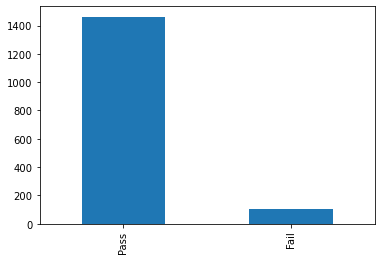

In [17]:
data.Classification.value_counts().plot(kind = 'bar')

In [18]:
data.shape

(1567, 592)

In [19]:
data.isnull().sum()

Classification     0
Timestamp          0
Feature_1          6
Feature_2          7
Feature_3         14
                  ..
Feature_586        1
Feature_587        1
Feature_588        1
Feature_589        1
Feature_590        1
Length: 592, dtype: int64

In [20]:
data.isnull().sum().sum()

41951

<AxesSubplot:xlabel='index', ylabel='Missing Values'>

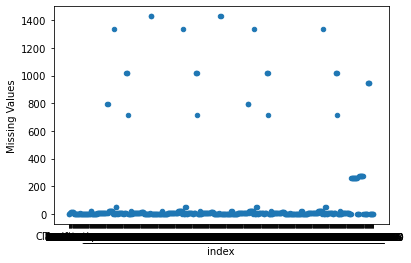

In [21]:
data.isna().sum().reset_index(name="Missing Values").plot.scatter(x='index', y="Missing Values")

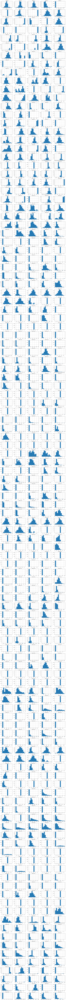

In [22]:
import matplotlib.pyplot as plt
%matplotlib inline

fig, axis = plt.subplots(118,5,figsize=(20,300))
secom_data.hist(ax=axis)
plt.tight_layout()
plt.show()

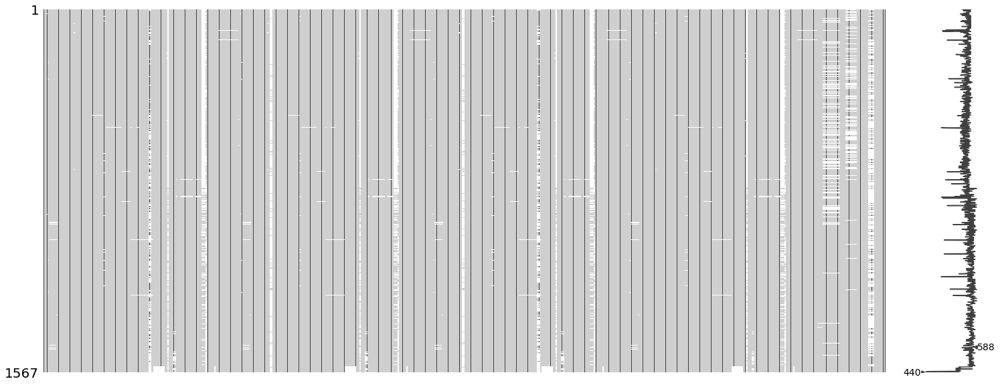

In [23]:
import missingno as msno
# Visualize missingness matrix
msno.matrix(data)
plt.show()

In [24]:
percent_missing = data.isnull().sum() * 100 / len(data)
missing_df = pd.DataFrame({'percent_missing': percent_missing})
missing = missing_df.sort_values(by=['percent_missing'],ascending=False)
missing.head(30)

,percent_missing
Feature_293,91.193363
Feature_159,91.193363
Feature_158,91.193363
Feature_294,91.193363
Feature_359,85.577537
Feature_493,85.577537
Feature_86,85.577537
Feature_221,85.577537
Feature_112,64.964901
Feature_111,64.964901


<function matplotlib.pyplot.show(close=None, block=None)>

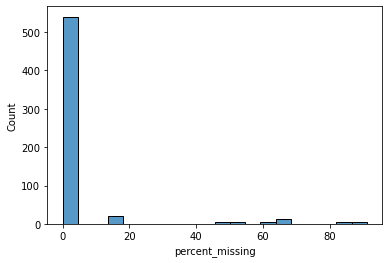

In [25]:
sns.histplot(data=missing,x="percent_missing",bins=20)
plt.show

In [29]:
## Storing features with Categorical Values 
categorical_features = []
for col in data.columns:
    if(data[col].unique().size <= 5):
        if(len(categorical_features) == 0):
            categorical_features =  data[col]
        else:
            categorical_features = pd.concat([categorical_features, data[col]], axis=1)
            #to drop the 123 columns
            #data.drop(col, axis=1, inplace=True)
categorical_features.head()
categorical_features.pop("Classification")

0       Pass
1       Pass
2       Fail
3       Pass
4       Pass
        ... 
1562    Pass
1563    Pass
1564    Pass
1565    Pass
1566    Pass
Name: Classification, Length: 1567, dtype: category
Categories (2, object): ['Fail', 'Pass']

In [30]:
highvariance = categorical_features.loc[:,categorical_features.std()>0]

In [31]:
highvariance.head()

,Feature_75,Feature_207,Feature_210,Feature_343,Feature_348,Feature_479
0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0


In [32]:
highvariance.std()

Feature_75     0.106190
Feature_207    0.050621
Feature_210    1.168074
Feature_343    0.011319
Feature_348    0.352186
Feature_479    5.062075
dtype: float64

In [33]:
corr = data.corr()
corr.style.background_gradient(cmap='coolwarm')
# 'RdBu_r', 'BrBG_r', & PuOr_r are other good diverging colormap

C:\Users\public\anaconda3\lib\site-packages\pandas\io\formats\style.py:2813: RuntimeWarning: All-NaN slice encountered
  smin = np.nanmin(gmap) if vmin is None else vmin
C:\Users\public\anaconda3\lib\site-packages\pandas\io\formats\style.py:2814: RuntimeWarning: All-NaN slice encountered
  smax = np.nanmax(gmap) if vmax is None else vmax


Text(0.5, 1.0, 'Heatmap for the Data')

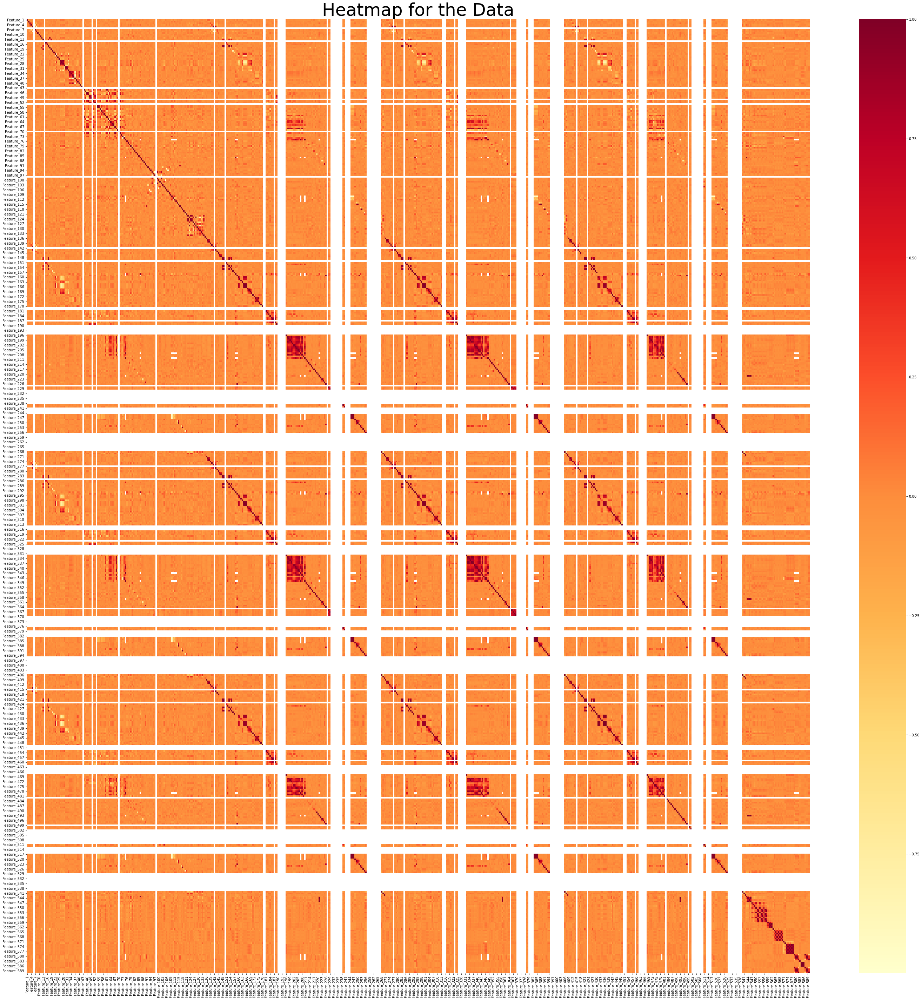

In [34]:
plt.rcParams['figure.figsize'] = (50,50)
sns.heatmap(data.corr(),cmap="YlOrRd")
plt.title('Heatmap for the Data', fontsize = 50)

In [35]:
#for col in data:
    #sns.boxplot(data=secom_data[col])

KeyError: 'Classification'

In [36]:
data.mean()

C:\Users\RASHMI~1\AppData\Local\Temp/ipykernel_8560/531903386.py:1: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  data.mean()
C:\Users\RASHMI~1\AppData\Local\Temp/ipykernel_8560/531903386.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  data.mean()


Feature_1      3014.452896
Feature_2      2495.850231
Feature_3      2200.547318
Feature_4      1396.376627
Feature_5         4.197013
                  ...     
Feature_586       3.067826
Feature_587       0.021458
Feature_588       0.016475
Feature_589       0.005283
Feature_590      99.670066
Length: 590, dtype: float64

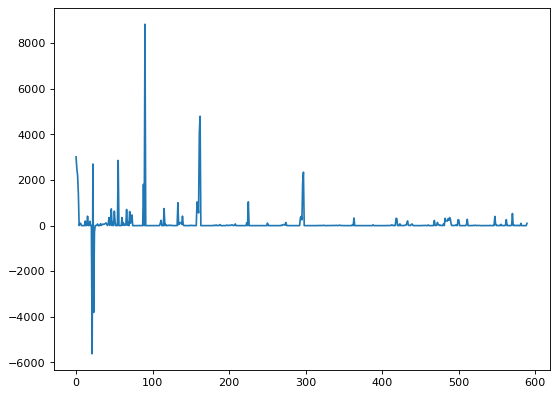

In [45]:
from matplotlib.pyplot import figure
figure(figsize=(8, 6), dpi=80)

mean = []
for col in secom_data.columns:
    m = data[col].mean()
    mean.append(m)
plt.plot(mean)
plt.show()

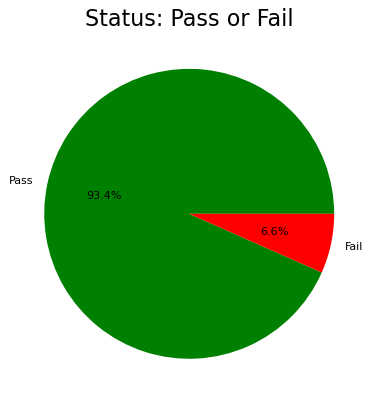

In [44]:
figure(figsize=(8, 6), dpi=80)
pie_data = data['Classification'].value_counts()
plt.pie(pie_data, labels=['Pass', 'Fail'], colors=['green', 'red'], autopct="%.1f%%")
plt.title('Status: Pass or Fail', fontsize=20)
plt.show()


C:\Users\RASHMI~1\AppData\Local\Temp/ipykernel_8560/2198603258.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  plt.plot(data.skew())


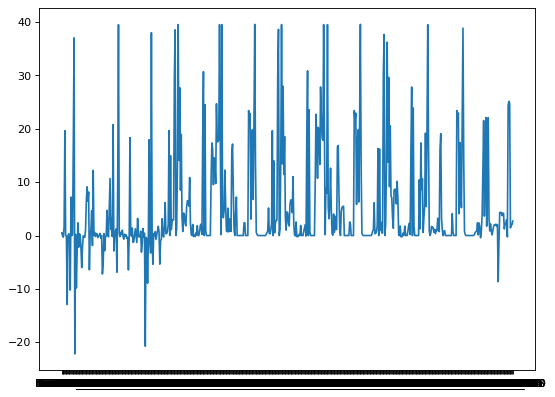

In [53]:
figure(figsize=(8, 6), dpi=80)
plt.plot(data.skew())